In [1]:
from pymongo import ASCENDING, GEOSPHERE, MongoClient
import pandas as pd
from alive_progress import alive_bar
from shapely.geometry import Point, mapping
from keplergl import KeplerGl
import shapely
import json
from os import listdir
from os.path import isfile, join
from tqdm import tqdm
import geopandas as gpd
from h3 import h3
import math
import sklearn
import numpy as np
import time

In [2]:
client = MongoClient('mongodb://localhost:27017/')
db = client.osmDataDB
coll_results = db.experimentsResults
coll_results_bak = db.experimentsResultsBak

In [3]:
results_new = [r for r in coll_results.find({'city': { '$in': ['Warszawa', 'Wrocław', 'Poznań']}})]
results_bak = [r for r in coll_results_bak.find({'city': { '$in': ['Warszawa', 'Wrocław', 'Poznań']}})]

In [4]:
print(len(results_new), len(results_bak))

5544 5071


In [5]:
results = results_new

In [6]:
def exists_result(res):
    city = res["city"]
    resolution = res["resolution"]
    inbalance_ratio = res["inbalance_ratio"]
    embedding_cls = res["embedding_cls"]
    neighbours = res["neighbours"]
    neighbour_embedding_cls = res["neighbour_embedding_cls"]
    x_processing = res["x_processing"]
    return any([r["city"] == city and r["resolution"] == resolution and r["inbalance_ratio"] == inbalance_ratio and r["embedding_cls"] == embedding_cls and r["neighbours"] == neighbours and r["neighbour_embedding_cls"] == neighbour_embedding_cls and r["x_processing"] == x_processing for r in results])

In [7]:
for result in tqdm(results_bak):
    if not exists_result(result):
        results.append(result)
len(results)

100%|██████████| 5071/5071 [00:09<00:00, 535.09it/s]


6878

In [13]:
# neighbour_embedding_cls_dict = {
#     'AverageDiminishingSquqredNeighbourEmbedding': 'Average Diminishing Squared Neighbour Embedding',
#     'ConcatenateNeighbourEmbedding': 'Concatenate Neighbour Embedding',
#     'AverageDiminishingNeighbourEmbedding': 'Average Diminishing Neighbour Embedding',
#     'AverageNeighbourEmbedding': 'Average Neighbour Embedding',
# }
processing_dict = {
    'None': 'None',
    # 'MinMaxScaler': 'Normalization',
    # 'StandardScaler': 'Standardization'
}
neighbour_embedding_cls_dict = {
    'AverageDiminishingSquqredNeighbourEmbedding': 'Average Diminishing Squared',
    'ConcatenateNeighbourEmbedding': 'Concatenate',
    'AverageDiminishingNeighbourEmbedding': 'Average Diminishing',
    'AverageNeighbourEmbedding': 'Average',
}
embedding_cls_dict = {
    'BaseCountCategoryEmbedding': 'Count Category Embedding',
    'BaseShapeAnalyzerEmbedding': 'Shape Analyzer Embedding',
    # 'PerCategoryShapeAnalyzerEmbedding300': 'All Tags Shape Analyzer\nEmbedding 300',
    # 'PerCategoryFilteredShapeAnalyzerEmbedding300': 'Selected Tags Shape Analyzer\nEmbedding 300'
}
metric_dict = {
    'accuracy': 'Accuracy',
    'f1_score': 'F1 Score',
    'custom_metric': 'Custom metric',
}
# parsed_results = []
flat_parsed_results = []
for r in results:
    for it in r['results']:
        if r['neighbour_embedding_cls'] in neighbour_embedding_cls_dict and \
            r['embedding_cls'] in embedding_cls_dict and \
            r['x_processing'] in processing_dict:
            # parsed_results.append({
            #     'city': r['city'],
            #     'resolution': r['resolution'],
            #     'inbalance_ratio': r['inbalance_ratio'],
            #     'embedding_cls': embedding_cls_dict[r['embedding_cls']],
            #     'neighbours': r['neighbours'],
            #     'neighbour_embedding_cls': neighbour_embedding_cls_dict[r['neighbour_embedding_cls']],
            #     'classfier_cls': it['classfier_cls'],
            #     'iteration': it['iteration'],
            #     'dataset_type': it['dataset_type'],
            #     'Accuracy': it['accuracy'],
            #     'F1 Score': it['f1_score'],
            #     'Custom metric': it['custom_metric'],
            # })
            for metric in ['accuracy', 'custom_metric', 'f1_score']:
                flat_parsed_results.append({
                    'city': r['city'],
                    'resolution': r['resolution'],
                    'inbalance_ratio': r['inbalance_ratio'],
                    'embedding_cls': embedding_cls_dict[r['embedding_cls']],
                    'neighbours': r['neighbours'],
                    'neighbour_embedding_cls': neighbour_embedding_cls_dict[r['neighbour_embedding_cls']],
                    'classfier_cls': it['classfier_cls'],
                    'processing': processing_dict[r['x_processing']],
                    'iteration': it['iteration'],
                    'dataset_type': it['dataset_type'],
                    'metric': metric_dict[metric],
                    'value': it[metric],
                })

In [14]:
df_flat = pd.DataFrame(flat_parsed_results)

In [37]:
for column in ['embedding_cls', 'neighbour_embedding_cls', 'classfier_cls', 'dataset_type', 'city']:
    values = list(df[column].unique())
    print(values)
    df[f'{column}_num'] = [values.index(v) for v in df[column]]
df

['Count Category Embedding', 'Shape Analyzer Embedding']
['Concatenate', 'Average Diminishing', 'Average Diminishing Squared', 'Average']
['KNeighborsClassifier', 'SVC', 'RandomForestClassifier', 'AdaBoostClassifier']
['test', 'validation']
['Poznań', 'Warszawa', 'Wrocław']


In [12]:
df.loc[df.city == 'Wrocław'].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 32960 entries, 57600 to 98879
Data columns (total 17 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   city                         32960 non-null  object 
 1   resolution                   32960 non-null  int64  
 2   inbalance_ratio              32960 non-null  int64  
 3   embedding_cls                32960 non-null  object 
 4   neighbours                   32960 non-null  int64  
 5   neighbour_embedding_cls      32960 non-null  object 
 6   classfier_cls                32960 non-null  object 
 7   iteration                    32960 non-null  int64  
 8   dataset_type                 32960 non-null  object 
 9   Accuracy                     32960 non-null  float64
 10  F1 Score                     32960 non-null  float64
 11  Custom metric                32960 non-null  float64
 12  embedding_cls_num            32960 non-null  int64  
 13  neighbour_em

In [14]:
import plotly.graph_objects as go
fig = go.Figure(
    layout=go.Layout(height=600, width=1600),
    data=go.Parcoords(
        # line = dict(color = df['f1_score'], colorscale = 'Electric', showscale = True),
        line = dict(color = df['Custom metric'], colorscale = 'Viridis', showscale = True),
        dimensions = [
             dict(ticktext = df['city'].unique(), tickvals = df['city_num'].unique(),
                        label = 'city', values = df['city_num']),
            dict(ticktext = df['dataset_type'].unique(), tickvals = df['dataset_type_num'].unique(),
                        label = 'dataset_type', values = df['dataset_type_num']),
            dict(ticktext = df['embedding_cls'].unique(), tickvals = df['embedding_cls_num'].unique(),
                 label = 'embedding_cls', values = df['embedding_cls_num']),
            dict(ticktext = df['neighbour_embedding_cls'].unique(), tickvals = df['neighbour_embedding_cls_num'].unique(),
                 label = 'neighbour_embedding_cls', values = df['neighbour_embedding_cls_num']),
            dict(ticktext = df['classfier_cls'].unique(), tickvals = df['classfier_cls_num'].unique(),
                        label = 'classfier_cls', values = df['classfier_cls_num']),
            dict(ticktext = df['resolution'].unique(), tickvals = df['resolution'].unique(),
                        label = 'resolution', values = df['resolution']),
            dict(ticktext = df['neighbours'].unique(), tickvals = df['neighbours'].unique(),
                        label = 'neighbours', values = df['neighbours']),
            dict(ticktext = df['inbalance_ratio'].unique(), tickvals = df['inbalance_ratio'].unique(),
                        label = 'inbalance_ratio', values = df['inbalance_ratio']),
            dict(range = [0.5,1],
                 label = 'Accuracy', values = df['Accuracy']),
            dict(range = [0.5,1],
                 label = 'Custom metric', values = df['Custom metric']),
            dict(range = [0,1],
                 label = 'F1 Score', values = df['F1 Score'])
        ]
    )
)
fig.show()

In [29]:
pd.options.display.max_rows = None

In [39]:
grpd = df_flat.groupby(['embedding_cls', 'resolution', 'neighbours', 'neighbour_embedding_cls']).count()
grpd
    

e Diminishing                  2880   
                                               Average Diminishing Squared          2880   
                                               Concatenate                          2880   
                                    20         Average                              2880   
                                               Average Diminishing                  2880   
                                               Average Diminishing Squared          2880   
                                               Concatenate                          2880   
                                    25         Average                              2880   
                                               Average Diminishing                  2880   
                                               Average Diminishing Squared          2880   
                                               Concatenate                          2880   

                                                                            metric  \
embedding_cls            resolution neighbours neighbour_embedding_cls               
Count Category Embedding 9          0          Concatenate                    2880   
                                    1          Average                        2880   
                                               Average Diminishing            2880   
                                               Average Diminishing Squared    2880   
                                               Concatenate                    2880   
                                    2          Average                        2880   
                                               Average Diminishing            2880   
                                               Average Diminishing Squared    2880   
                                               Concatenate                    2880   
                                    3          Average                        2880   
                                               Average Diminishing            2880   
                                               Average Diminishing Squared    2880   
                                               Concatenate                    2880   
                         10         0          Concatenate                    2880   
                                    2          Average                        2880   
                                               Average Diminishing            2880   
                                               Average Diminishing Squared    2880   
                                               Concatenate                    2880   
                                    4          Average                        2880   
                                               Average Diminishing            2880   
                                               Average Diminishing Squared    2880   
                                               Concatenate                    2880   
                                    6          Average                        2880   
                                               Average Diminishing            2880   
                                               Average Diminishing Squared    2880   
                                               Concatenate                    2880   
                                    8          Average                        2880   
                                               Average Diminishing            2880   
                                               Average Diminishing Squared    2880   
                                               Concatenate                    2880   
                                    10         Average                        2880   
                                               Average Diminishing            2880   
                                               Average Diminishing Squared    2880   
                              

In [15]:
import seaborn as sns
import matplotlib.pyplot as plt
# sns.set_theme()
sns.set_style("whitegrid")
# sns.set_style("white")

In [16]:
NEIGHBORS = {
    9: [0,1,2,3],
    10: [0,2,4,6,8,10],
    11: [0,5,10,15,20,25]
}

NEIGHBORS_DIST = {
    9: (0.955, 0.227, 0.09),
    10: (0.955, 0.151, 0.055),
    11: (0.955, 0.151, 0.055),
}

In [17]:
def vertical_mean_line(x, y, res, **kwargs):
    neighbours = NEIGHBORS[res]
    # dist = (1 / len(neighbours)) - 0.02
    # print(neighbours, dist)
    ax = plt.gca()
    for i, n in enumerate(neighbours):
        x_filtered = x.loc[y == str(n)]
        v = x_filtered.mean()
        top, dist, buffer = NEIGHBORS_DIST[res]
        plt.axvline(v, ymin=top - (dist + dist * i), ymax=top - (dist * i), **kwargs)
        ax.text(0.1, top - (buffer + dist * i), f"{v:.3f}", color='k', transform=ax.get_xaxis_transform(), ha='center', va='top')
        ax.yaxis.grid(False)
    # for i, inbalance_ratio in enumerate(['1','2','3','5']):
    #     x_filtered = x.loc[y == inbalance_ratio]
    #     v = x_filtered.mean()
    #     # plt.axvline(v, ymin=1 - (0.25 + 0.25 * i), ymax=1 - (0.25 * i), **kwargs)
    #     plt.axvline(v, ymin=0.96 - (0.23 + 0.23 * i), ymax=0.96 - (0.23 * i), **kwargs)
    #     ax.text(0.1, 0.96 - (0.1 + 0.23 * i), f"{v:.3f}", color='k', transform=ax.get_xaxis_transform(), ha='center', va='top')
    #     ax.yaxis.grid(False)

def vertical_mean_line_base(x, **kwargs):
    ax = plt.gca()
    v = x.mean()
    plt.axvline(v, ymin=0.05, **kwargs)
    ax.text(v, .03, f"{v:.3f}", color='k', transform=ax.get_xaxis_transform(),
            ha='center', va='top')

<ipython-input-18-99f5a81d59ac>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df['inbalance_ratio_str'] = filtered_df['inbalance_ratio'].apply(lambda value: str(value))
<ipython-input-18-99f5a81d59ac>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df['neighbours_str'] = filtered_df['neighbours'].apply(lambda value: str(value))
<ipython-input-18-99f5a81d59ac>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_in

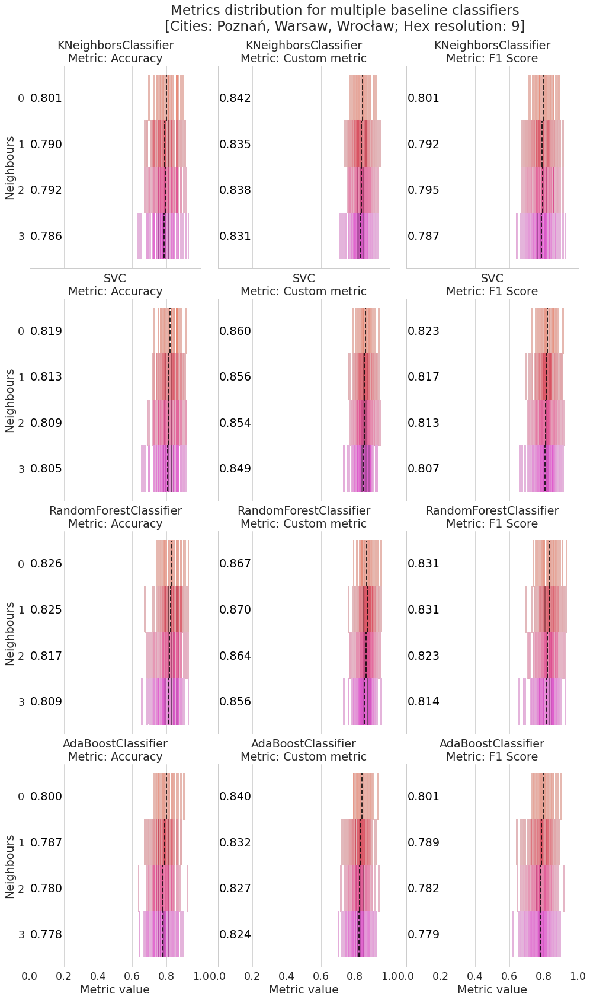

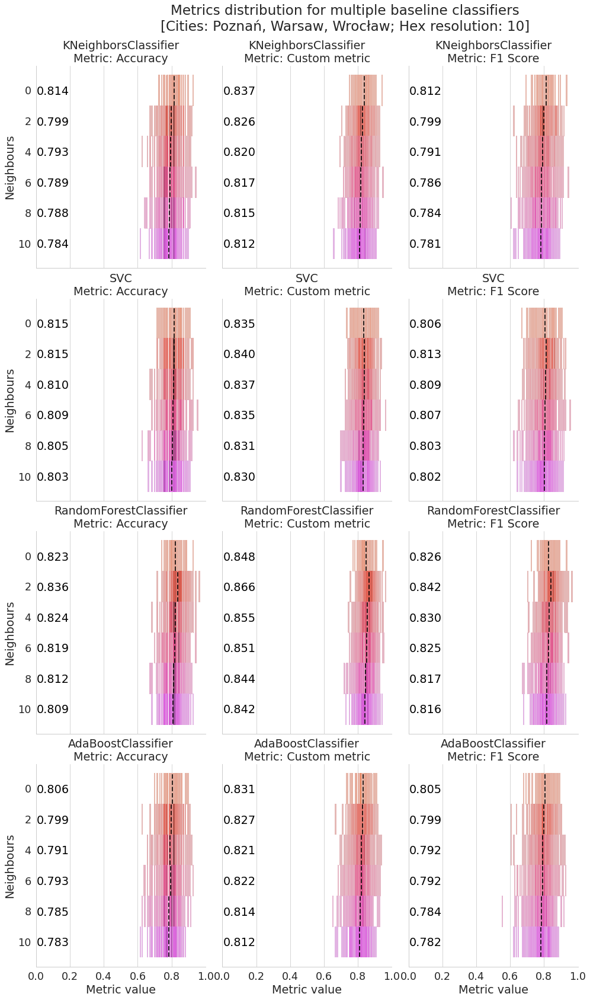

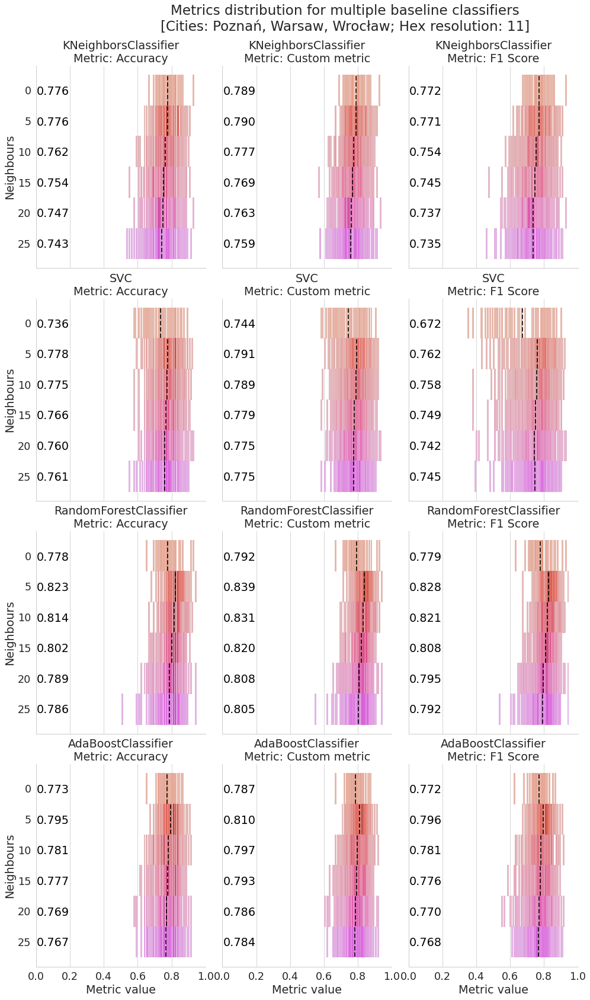

In [18]:
# sns.set_context("paper", font_scale=2, rc={"lines.linewidth": 4})
sns.set_context("paper", font_scale=2, rc={"lines.linewidth": 2})
# with sns.plotting_context(font_scale=1.5):
for res in [9, 10, 11]:
# for res in [9]:
# for metric in ['f1_score', 'accuracy', 'custom_metric']:
    filtered_df = df_flat.loc[(df_flat.resolution == res) & (df_flat.dataset_type == 'validation') & (df_flat.inbalance_ratio == 1)]
    filtered_df['inbalance_ratio_str'] = filtered_df['inbalance_ratio'].apply(lambda value: str(value))
    filtered_df['neighbours_str'] = filtered_df['neighbours'].apply(lambda value: str(value))
    g = sns.displot(
        data=filtered_df, x="value", 
        y="neighbours_str",
        # y="processing",
        # y="processing",
        row="classfier_cls",
        col="metric",
        hue="neighbours_str",
        # facet_kws=dict(row_order=['Concatenate', 'Average', 'Average Diminishing', 'Average Diminishing Squared']),
        # kind="kde", 
        height=6, aspect=0.8, palette="flare"
    )
    plt.xlim(0, 1)

    # g.set_axis_labels("Density", f"Metric: {metric}")
    # g.map(vertical_mean_line, 'value', 'inbalance_ratio_str', color='k', ls='--', alpha=0.5, res=res)
    g.map(vertical_mean_line, 'value', 'neighbours_str', color='k', ls='--', alpha=0.8, res=res)
    # g.set_axis_labels("Metric value", "Inbalance ratio")
    g.set_axis_labels("Metric value", "Neighbours")
    # g.set_axis_labels("Metric value", "Density")
    g.set_titles("{row_name}\nMetric: {col_name}")
    g.fig.subplots_adjust(wspace=0.1, hspace=0.15)
    g.fig.subplots_adjust(top=0.92) # adjust the Figure in rp
    g.fig.suptitle(f'Metrics distribution for multiple baseline classifiers\n[Cities: Poznań, Warsaw, Wrocław; Hex resolution: {res}]')
    # plt.legend(title='Neighbourhood size')
    g._legend.remove()
    # g._legend.set_title("Neighbourhood\nsize")
    # g._legend.get_title().set_multialignment('center')
    # plt.tight_layout()
    plt.savefig(f'classifiers_2_{res}.pdf', dpi=300, format='pdf', bbox_inches='tight')